In [107]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import warnings

import plotly as px
import datetime as datetime
import seaborn as sns

In [108]:
import shapefile as shp
import matplotlib.tri as tri

In [109]:
# data=pd.read_csv("output_data.csv")
data=pd.read_csv("final_data.csv")
data["t2m"]-=273.15

In [110]:
data

,time,latitude,longitude,t2m
0,2018-01-01 00:00:00,39.39,-123.77,12.12734
1,2018-01-01 00:00:00,39.39,-123.52,11.95498
2,2018-01-01 00:00:00,39.39,-123.27,11.34854
3,2018-01-01 00:00:00,39.39,-123.02,10.64688
4,2018-01-01 00:00:00,39.39,-122.77,10.46475
...,...,...,...,...
136075,2022-12-01 14:00:00,35.14,-119.77,6.99282
136076,2022-12-01 14:00:00,35.14,-119.52,7.37515
136077,2022-12-01 14:00:00,35.14,-119.27,6.98452
136078,2022-12-01 14:00:00,35.14,-119.02,6.28480


In [111]:
data["time"]=pd.to_datetime(data["time"])
data
data.rename({"latitude":"lat","longitude":"lon"}, axis='columns',inplace=True)
data

,time,lat,lon,t2m
0,2018-01-01 00:00:00,39.39,-123.77,12.12734
1,2018-01-01 00:00:00,39.39,-123.52,11.95498
2,2018-01-01 00:00:00,39.39,-123.27,11.34854
3,2018-01-01 00:00:00,39.39,-123.02,10.64688
4,2018-01-01 00:00:00,39.39,-122.77,10.46475
...,...,...,...,...
136075,2022-12-01 14:00:00,35.14,-119.77,6.99282
136076,2022-12-01 14:00:00,35.14,-119.52,7.37515
136077,2022-12-01 14:00:00,35.14,-119.27,6.98452
136078,2022-12-01 14:00:00,35.14,-119.02,6.28480


In [112]:
data["month"]=data["time"].dt.month
data["year"]=data["time"].dt.year
data

,time,lat,lon,t2m,month,year
0,2018-01-01 00:00:00,39.39,-123.77,12.12734,1,2018
1,2018-01-01 00:00:00,39.39,-123.52,11.95498,1,2018
2,2018-01-01 00:00:00,39.39,-123.27,11.34854,1,2018
3,2018-01-01 00:00:00,39.39,-123.02,10.64688,1,2018
4,2018-01-01 00:00:00,39.39,-122.77,10.46475,1,2018
...,...,...,...,...,...,...
136075,2022-12-01 14:00:00,35.14,-119.77,6.99282,12,2022
136076,2022-12-01 14:00:00,35.14,-119.52,7.37515,12,2022
136077,2022-12-01 14:00:00,35.14,-119.27,6.98452,12,2022
136078,2022-12-01 14:00:00,35.14,-119.02,6.28480,12,2022


In [113]:
data["time"].dt.hour.unique()

array([ 0,  1,  2, 12, 13, 14], dtype=int64)

In [114]:
data["time_of_day"]=data["time"].dt.hour.apply(lambda x:"night" if x<=2 else "day")
data

,time,lat,lon,t2m,month,year,time_of_day
0,2018-01-01 00:00:00,39.39,-123.77,12.12734,1,2018,night
1,2018-01-01 00:00:00,39.39,-123.52,11.95498,1,2018,night
2,2018-01-01 00:00:00,39.39,-123.27,11.34854,1,2018,night
3,2018-01-01 00:00:00,39.39,-123.02,10.64688,1,2018,night
4,2018-01-01 00:00:00,39.39,-122.77,10.46475,1,2018,night
...,...,...,...,...,...,...,...
136075,2022-12-01 14:00:00,35.14,-119.77,6.99282,12,2022,day
136076,2022-12-01 14:00:00,35.14,-119.52,7.37515,12,2022,day
136077,2022-12-01 14:00:00,35.14,-119.27,6.98452,12,2022,day
136078,2022-12-01 14:00:00,35.14,-119.02,6.28480,12,2022,day


In [115]:
data[(data["lat"].between(36.39,39.39))]

,time,lat,lon,t2m,month,year,time_of_day
0,2018-01-01 00:00:00,39.39,-123.77,12.12734,1,2018,night
1,2018-01-01 00:00:00,39.39,-123.52,11.95498,1,2018,night
2,2018-01-01 00:00:00,39.39,-123.27,11.34854,1,2018,night
3,2018-01-01 00:00:00,39.39,-123.02,10.64688,1,2018,night
4,2018-01-01 00:00:00,39.39,-122.77,10.46475,1,2018,night
...,...,...,...,...,...,...,...
135970,2022-12-01 14:00:00,36.39,-119.77,6.32340,12,2022,day
135971,2022-12-01 14:00:00,36.39,-119.52,6.45425,12,2022,day
135972,2022-12-01 14:00:00,36.39,-119.27,6.26675,12,2022,day
135973,2022-12-01 14:00:00,36.39,-119.02,5.11294,12,2022,day


In [116]:
data["date"]=data["time"].dt.date

### forest

In [117]:
# data_forest=data[(data["lat"].between(36.39,39.39)) & (data["lon"].between(-121.27,-118.77))]
data_forest=data.copy()
data_forest.reset_index(inplace=True)

In [118]:
index_temp1=[]

for i in range(len(data_forest["lat"])):
    y_temp=((-2.75*data_forest["lat"][i])-(256.2375))/(3)
    if(data_forest["lon"][i]>y_temp):
        index_temp1.append(i)


In [119]:
len(data_forest["lat"])

136080

In [120]:
data_forest=data_forest.filter(items=index_temp1,axis=0)

In [121]:
data_forest

,index,time,lat,lon,t2m,month,year,time_of_day,date
10,10,2018-01-01 00:00:00,39.39,-121.27,12.87100,1,2018,night,2018-01-01
11,11,2018-01-01 00:00:00,39.39,-121.02,10.98135,1,2018,night,2018-01-01
12,12,2018-01-01 00:00:00,39.39,-120.77,8.20156,1,2018,night,2018-01-01
13,13,2018-01-01 00:00:00,39.39,-120.52,5.86562,1,2018,night,2018-01-01
14,14,2018-01-01 00:00:00,39.39,-120.27,4.73770,1,2018,night,2018-01-01
...,...,...,...,...,...,...,...,...,...
135910,135910,2022-12-01 14:00:00,37.14,-119.02,-5.71420,12,2022,day,2022-12-01
135911,135911,2022-12-01 14:00:00,37.14,-118.77,-6.86265,12,2022,day,2022-12-01
135931,135931,2022-12-01 14:00:00,36.89,-119.02,-1.66830,12,2022,day,2022-12-01
135932,135932,2022-12-01 14:00:00,36.89,-118.77,-5.52476,12,2022,day,2022-12-01


### sea

In [122]:
data_sea=data.copy()
data_sea.reset_index(inplace=True)

In [124]:
index_temp2=[]

for i in range(len(data_sea["lat"])):
    y_temp=((-2.75*data_sea["lat"][i])-(357.19))/(3.75)
    if(data_sea["lon"][i]<y_temp):
        index_temp2.append(i)

In [125]:
data_sea=data_sea.filter(items=index_temp2,axis=0)

### land

In [126]:
data_land=data.copy()
data_land.reset_index(inplace=True)

In [127]:
data_land=data_land[~data_land["index"].isin(index_temp1) &  ~data_land["index"].isin(index_temp2)]

# Analysis

In [128]:
lat=np.array(data["lat"])
lon=np.array(data["lon"])


<AxesSubplot:xlabel='lat', ylabel='lon'>

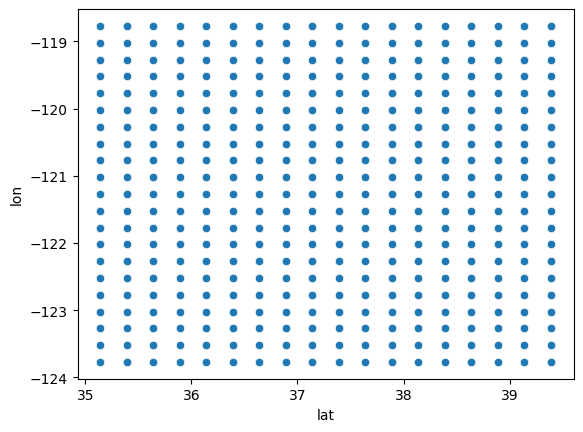

In [129]:
sns.scatterplot(data=data,x="lat",y="lon")

In [130]:
ds["t2m"][2].plot()

NameError: name 'ds' is not defined

In [131]:

data["time"]=data["time"].astype("string")
data

,time,lat,lon,t2m,month,year,time_of_day,date
0,2018-01-01 00:00:00,39.39,-123.77,12.12734,1,2018,night,2018-01-01
1,2018-01-01 00:00:00,39.39,-123.52,11.95498,1,2018,night,2018-01-01
2,2018-01-01 00:00:00,39.39,-123.27,11.34854,1,2018,night,2018-01-01
3,2018-01-01 00:00:00,39.39,-123.02,10.64688,1,2018,night,2018-01-01
4,2018-01-01 00:00:00,39.39,-122.77,10.46475,1,2018,night,2018-01-01
...,...,...,...,...,...,...,...,...
136075,2022-12-01 14:00:00,35.14,-119.77,6.99282,12,2022,day,2022-12-01
136076,2022-12-01 14:00:00,35.14,-119.52,7.37515,12,2022,day,2022-12-01
136077,2022-12-01 14:00:00,35.14,-119.27,6.98452,12,2022,day,2022-12-01
136078,2022-12-01 14:00:00,35.14,-119.02,6.28480,12,2022,day,2022-12-01


In [132]:
import plotly.express as px
fig = px.density_mapbox(data, lat='lat', lon='lon', z='t2m', radius=25,animation_frame="time",opacity=0.8,mapbox_style="stamen-terrain",range_color=[-15, 50])
fig.update_layout(width=800, height=600)
fig.show()
np.max(data["t2m"])

40.83022

### Forest

In [133]:
data_forest["time"]=data_forest["time"].astype("string")

In [134]:
import plotly.express as px

fig = px.density_mapbox(data_forest, lat='lat', lon='lon', z='t2m', radius=25,animation_frame="time",opacity=0.7,mapbox_style="stamen-terrain",range_color=[-15, 50])
fig.update_layout(width=800, height=600)
fig.show()
np.max(data["t2m"])

40.83022

### Sea

In [135]:
data_sea["time"]=data_sea["time"].astype("string")

In [136]:
fig = px.density_mapbox(data_sea, lat='lat', lon='lon', z='t2m', radius=25,animation_frame="time",opacity=0.4,mapbox_style="stamen-terrain",range_color=[-15, 50])
fig.update_layout(width=800, height=600)
fig.show()
np.max(data["t2m"])

40.83022

### Land


In [137]:
data_land["time"]=data_land["time"].astype("string")

In [138]:
fig = px.density_mapbox(data_land, lat='lat', lon='lon', z='t2m', radius=25,animation_frame="time",opacity=0.4,mapbox_style="stamen-terrain",range_color=[-15, 50])
fig.update_layout(width=800, height=600)
fig.show()
np.max(data["t2m"])

40.83022

### Temperatures around year

#### forest

<AxesSubplot:xlabel='time', ylabel='t2m'>

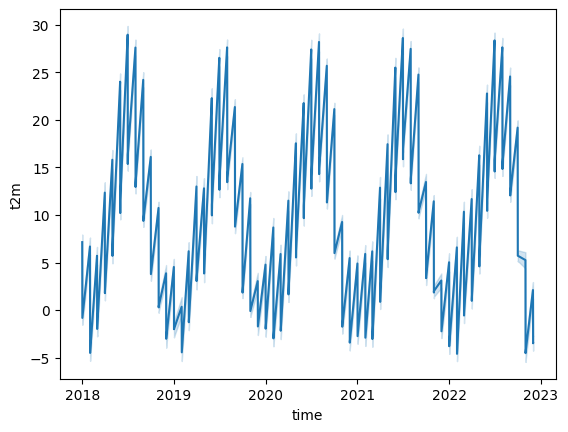

In [23]:
sns.lineplot(data=data_forest,x="time",y="t2m")

[Text(0.5, 1.0, 'Average temp')]

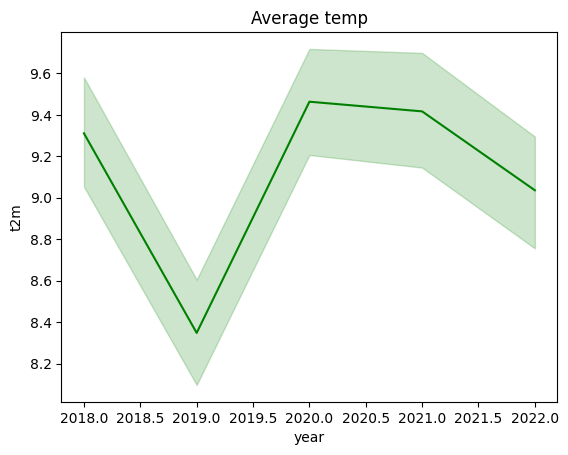

In [24]:
sns.lineplot(data=data_forest,x="year",y="t2m",color="g").set(title="Average temp")

<AxesSubplot:xlabel='month', ylabel='t2m'>

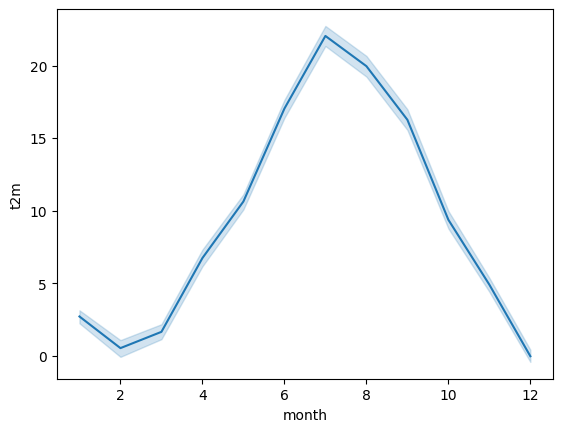

In [25]:
sns.lineplot(data=data_forest[data_forest["year"]==2018],x="month",y="t2m")

<AxesSubplot:xlabel='month', ylabel='t2m'>

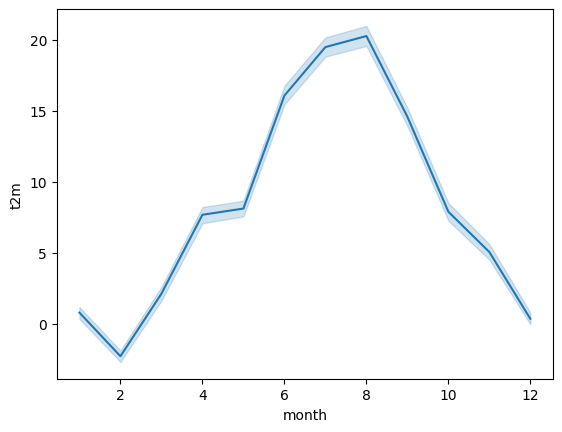

In [26]:
sns.lineplot(data=data_forest[data_forest["year"]==2019],x="month",y="t2m")

<AxesSubplot:xlabel='month', ylabel='t2m'>

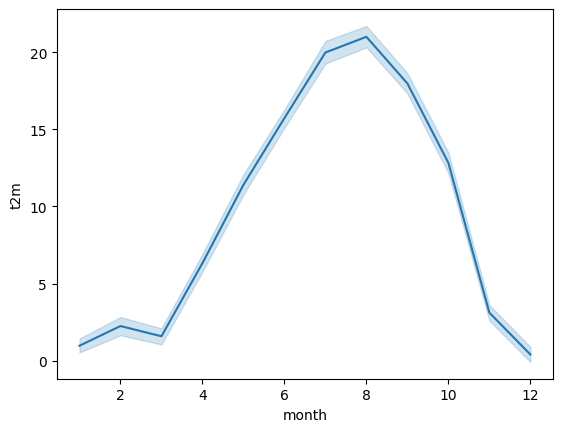

In [27]:
sns.lineplot(data=data_forest[data_forest["year"]==2020],x="month",y="t2m")

In [129]:
print(np.max(data_forest[data_forest["year"]==2018]["t2m"]),np.min(data_forest[data_forest["year"]==2018]["t2m"]))

37.052400000000034 -10.952979999999968


In [102]:
print(np.max(data_forest[data_forest["year"]==2019]["t2m"]),np.min(data_forest[data_forest["year"]==2019]["t2m"]))

34.688620000000014 -10.890479999999968


In [103]:
print(np.max(data_forest[data_forest["year"]==2020]["t2m"]),np.min(data_forest[data_forest["year"]==2020]["t2m"]))

35.888570000000016 -9.514259999999979


In [104]:
print(np.max(data_forest[data_forest["year"]==2021]["t2m"]),np.min(data_forest[data_forest["year"]==2021]["t2m"]))

37.34097000000003 -9.23739999999998


In [105]:
print(np.max(data_forest[data_forest["year"]==2022]["t2m"]),np.min(data_forest[data_forest["year"]==2022]["t2m"]))

36.547500000000014 -10.362899999999968


[Text(0.5, 1.0, 'Temperature Vs time of day')]

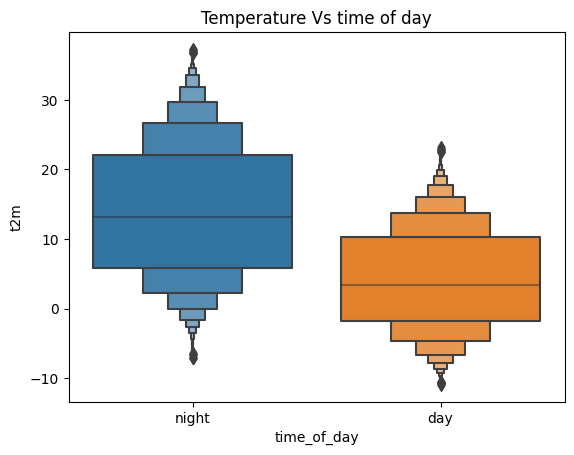

In [28]:
sns.boxenplot(data=data_forest,y="t2m",x="time_of_day").set(title="Temperature Vs time of day")

In [29]:
print("2018","Max:",np.max(data_forest[data_forest["year"]==2018]["t2m"]),"Min:",np.min(data_forest[data_forest["year"]==2018]["t2m"]))
print("2019","Max:",np.max(data_forest[data_forest["year"]==2019]["t2m"]),"Min:",np.min(data_forest[data_forest["year"]==2019]["t2m"]))
print("2020","Max:",np.max(data_forest[data_forest["year"]==2020]["t2m"]),"Min:",np.min(data_forest[data_forest["year"]==2020]["t2m"]))
print("2021","Max:",np.max(data_forest[data_forest["year"]==2021]["t2m"]),"Min:",np.min(data_forest[data_forest["year"]==2021]["t2m"]))
print("2022","Max:",np.max(data_forest[data_forest["year"]==2022]["t2m"]),"Min:",np.min(data_forest[data_forest["year"]==2022]["t2m"]))

2018 Max: 37.052400000000034 Min: -10.952979999999968
2019 Max: 34.688620000000014 Min: -10.890479999999968
2020 Max: 35.888570000000016 Min: -9.514259999999979
2021 Max: 37.34097000000003 Min: -9.23739999999998
2022 Max: 36.547500000000014 Min: -10.362899999999968


<AxesSubplot:xlabel='index', ylabel='t2m'>

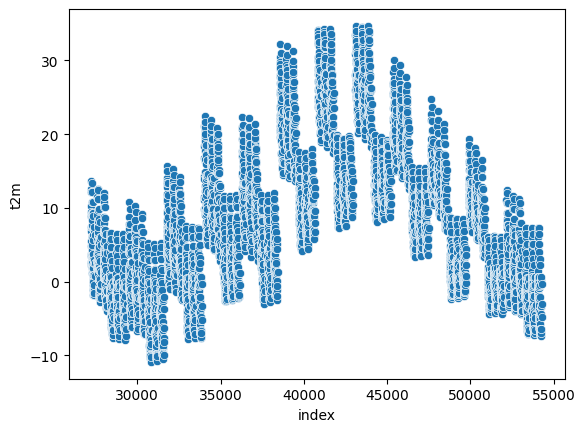

In [30]:
sns.scatterplot(data=data_forest[data_forest["year"]==2019],x="index",y="t2m")

In [102]:
data_forest["lon"].unique()

array([-121.27, -121.02, -120.77, -120.52, -120.27, -120.02, -119.77,
       -119.52, -119.27, -119.02, -118.77])

[Text(0.5, 1.0, 'Jones Fire 2020')]

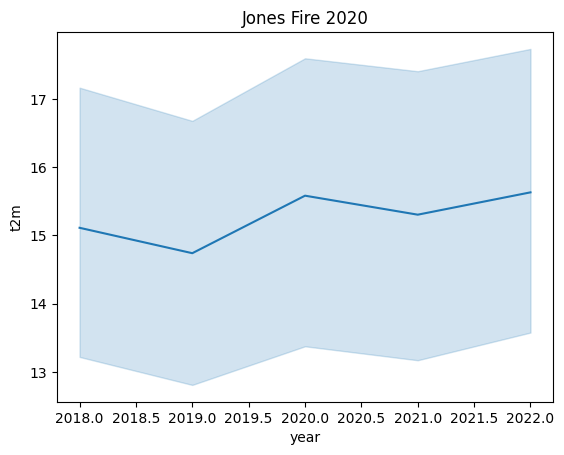

In [69]:
forest_fire=data_forest[(data_forest["lat"]==39.14) & (data_forest["lon"]==-121.02)] # Jones fire
sns.lineplot(data=forest_fire,x="year",y="t2m").set(title="Jones Fire 2020")

[Text(0.5, 1.0, 'Candy Fire  2020')]

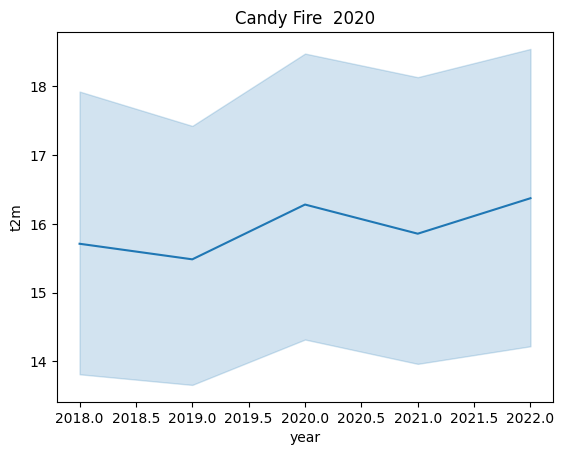

In [71]:
forest_fire=data_forest[(data_forest["lat"]==39.39) & (data_forest["lon"]==-121.27)] # Jones fire
sns.lineplot(data=forest_fire,x="year",y="t2m").set(title="Candy Fire  2020")

[Text(0.5, 1.0, 'Humboldt-Toiyabe National Forest 2021')]

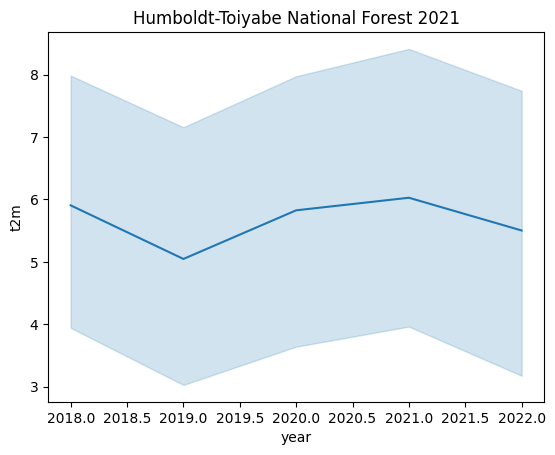

In [106]:
forest_fire=data_forest[(data_forest["lat"]==38.64) & (data_forest["lon"]==-119.77)] # Humboldt-Toiyabe National Forest
sns.lineplot(data=forest_fire,x="year",y="t2m").set(title="Humboldt-Toiyabe National Forest 2021")

<AxesSubplot:xlabel='index', ylabel='t2m'>

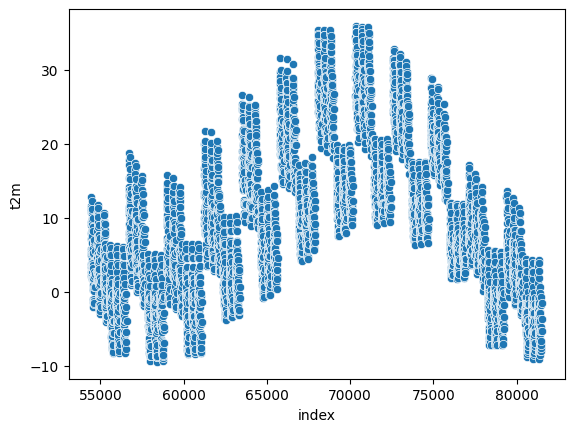

In [147]:
sns.scatterplot(data=data_forest[data_forest["year"]==2020],x="index",y="t2m")

<AxesSubplot:xlabel='index', ylabel='t2m'>

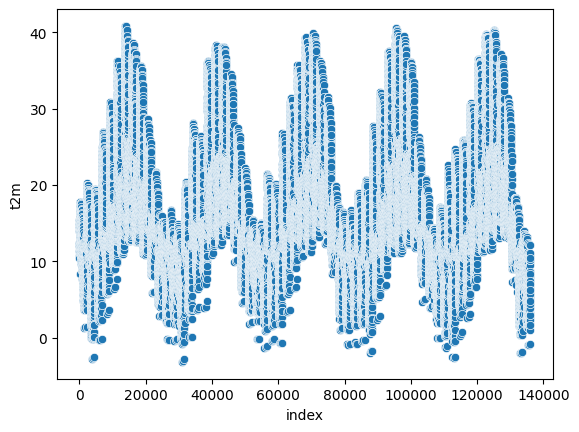

In [145]:
sns.scatterplot(data=data_land,x="index",y="t2m")

In [53]:
temp=data_forest.copy()
temp.set_index("date",drop=True,inplace=True)
temp=temp["t2m"]

In [56]:
temp=temp["t2m"]

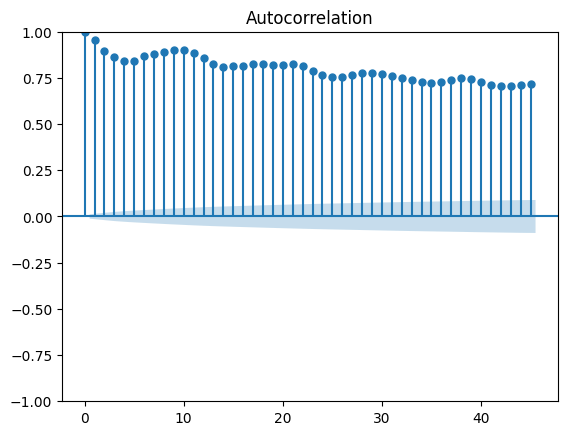

In [63]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
plot_acf(temp)
plt.show()

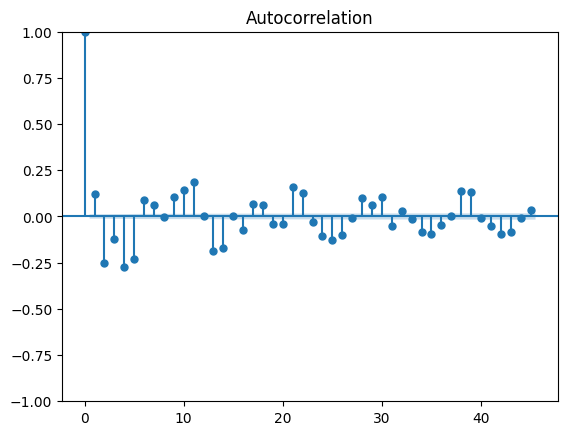

In [58]:

temp_diff=temp.diff(periods=1)
plot_acf(temp_diff[1:])
plt.show()

In [60]:
temp

date
2018-01-01    12.87100
2018-01-01    10.98135
2018-01-01     8.20156
2018-01-01     5.86562
2018-01-01     4.73770
                ...   
2022-12-01    -5.71420
2022-12-01    -6.86265
2022-12-01    -1.66830
2022-12-01    -5.52476
2022-12-01    -3.95737
Name: t2m, Length: 27720, dtype: float64

Figure(640x480)
Figure(640x480)


c:\Python\Python39\lib\site-packages\statsmodels\graphics\tsaplots.py:348: FutureWarning:

The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.



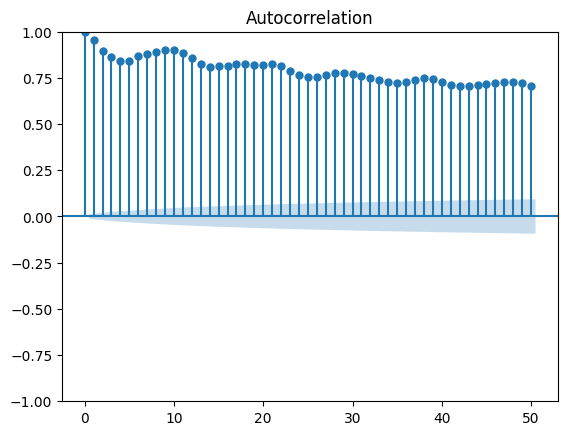

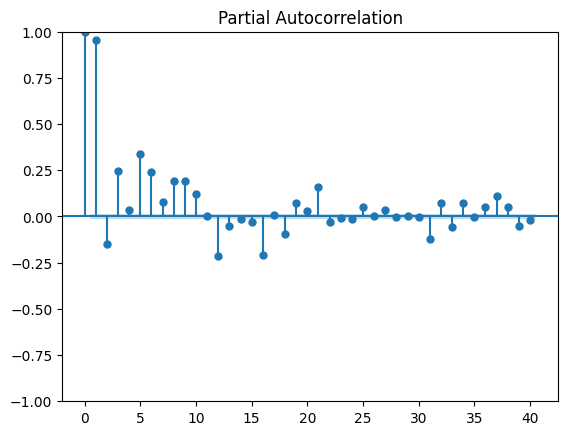

In [68]:
print(plot_acf(temp,lags=50))
print(plot_pacf(temp,lags=40))

#### land

<AxesSubplot:xlabel='time', ylabel='t2m'>

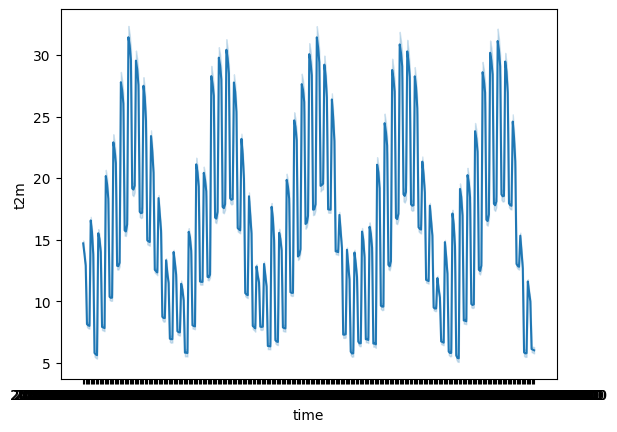

In [153]:
sns.lineplot(data=data_land,x="time",y="t2m")

<AxesSubplot:xlabel='year', ylabel='t2m'>

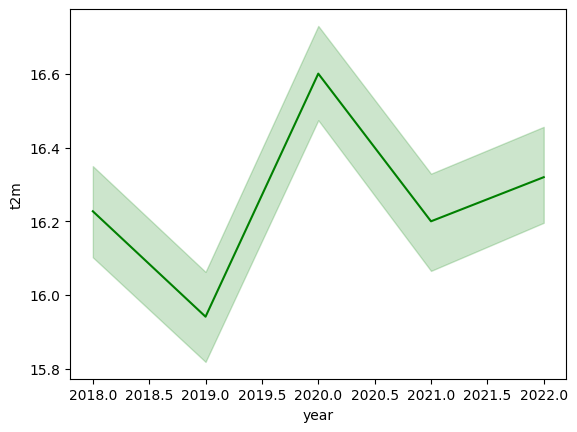

In [154]:
sns.lineplot(data=data_land,x="year",y="t2m",color="g")

[Text(0.5, 1.0, 'Temperature Vs time of day')]

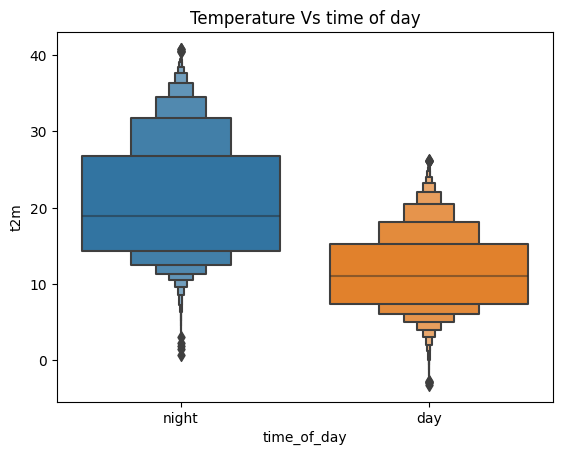

In [72]:
sns.boxenplot(data=data_land,y="t2m",x="time_of_day").set(title="Temperature Vs time of day")

<AxesSubplot:xlabel='time_of_day', ylabel='t2m'>

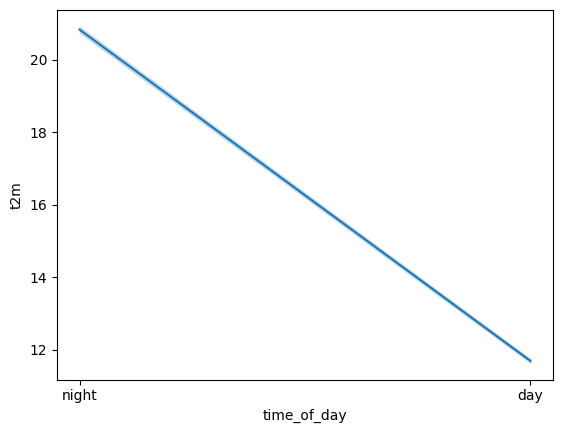

In [115]:
sns.lineplot(data=data_land,x="time_of_day",y="t2m")

In [109]:
print(np.max(data_land[data_land["year"]==2018]["t2m"]),np.min(data_land[data_land["year"]==2018]["t2m"]))
print(np.max(data_land[data_land["year"]==2019]["t2m"]),np.min(data_land[data_land["year"]==2019]["t2m"]))
print(np.max(data_land[data_land["year"]==2020]["t2m"]),np.min(data_land[data_land["year"]==2020]["t2m"]))
print(np.max(data_land[data_land["year"]==2021]["t2m"]),np.min(data_land[data_land["year"]==2021]["t2m"]))
print(np.max(data_land[data_land["year"]==2022]["t2m"]),np.min(data_land[data_land["year"]==2022]["t2m"]))

40.83022 -2.8216299999999706
38.38930000000005 -3.1863799999999856
39.89150000000001 -1.3321299999999496
40.58510000000001 -2.0174299999999903
40.23525000000001 -2.734960000000001


In [90]:
temp=data_land.copy()
temp.set_index("date",drop=True,inplace=True)
temp=temp["t2m"]

Figure(640x480)
Figure(640x480)


c:\Python\Python39\lib\site-packages\statsmodels\graphics\tsaplots.py:348: FutureWarning:

The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.



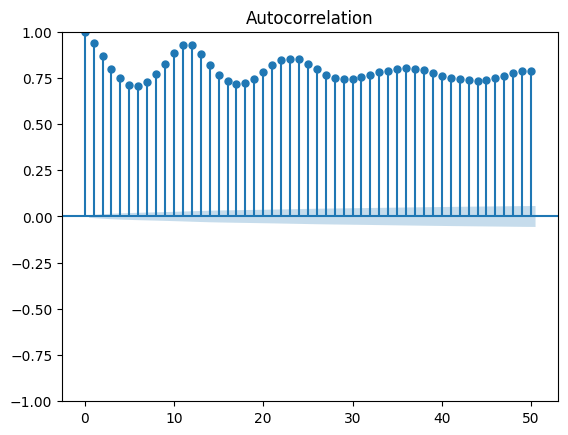

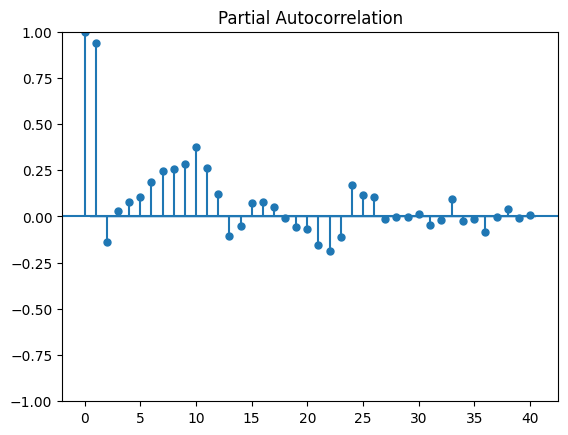

In [91]:
print(plot_acf(temp,lags=50))
print(plot_pacf(temp,lags=40))

#### Sea

<AxesSubplot:xlabel='time', ylabel='t2m'>

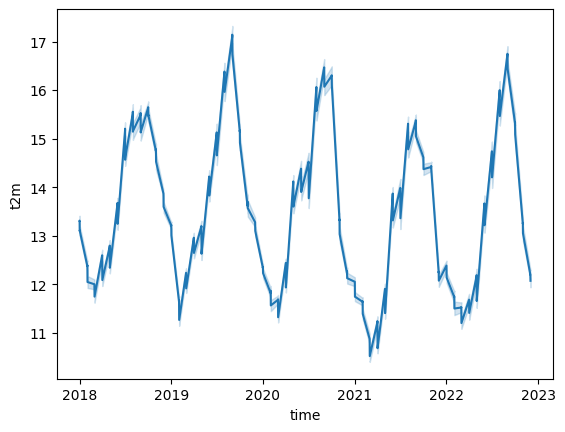

In [111]:
sns.lineplot(data=data_sea,x="time",y="t2m")

<AxesSubplot:xlabel='year', ylabel='t2m'>

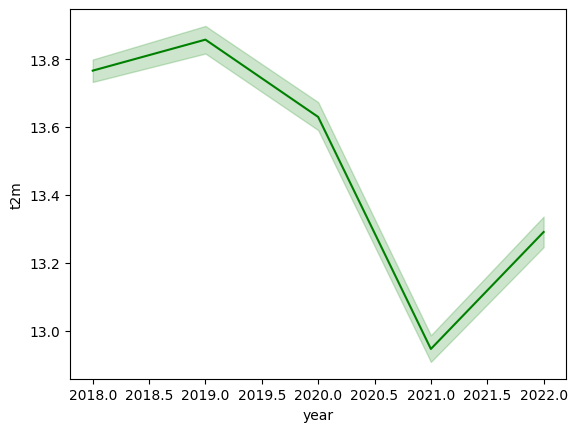

In [73]:
sns.lineplot(data=data_sea,x="year",y="t2m",color="g")

In [113]:
data_sea

,index,time,lat,lon,t2m,month,year,time_of_day
63,63,2018-01-01 00:00:00,38.64,-123.77,12.25625,1,2018,night
84,84,2018-01-01 00:00:00,38.39,-123.77,12.47256,1,2018,night
85,85,2018-01-01 00:00:00,38.39,-123.52,12.35635,1,2018,night
105,105,2018-01-01 00:00:00,38.14,-123.77,12.56338,1,2018,night
106,106,2018-01-01 00:00:00,38.14,-123.52,12.58145,1,2018,night
...,...,...,...,...,...,...,...,...
136065,136065,2022-12-01 14:00:00,35.14,-122.27,12.70278,12,2022,day
136066,136066,2022-12-01 14:00:00,35.14,-122.02,12.61392,12,2022,day
136067,136067,2022-12-01 14:00:00,35.14,-121.77,12.63198,12,2022,day
136068,136068,2022-12-01 14:00:00,35.14,-121.52,12.75356,12,2022,day


<AxesSubplot:xlabel='time_of_day', ylabel='t2m'>

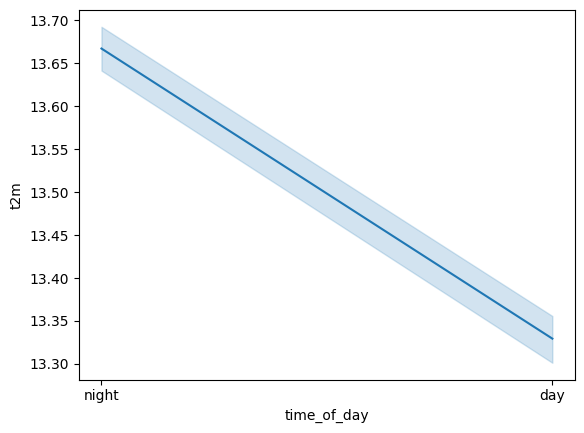

In [114]:
sns.lineplot(data=data_sea,x="time_of_day",y="t2m")

In [92]:
temp=data_sea.copy()
temp.set_index("date",drop=True,inplace=True)
temp=temp["t2m"]